In [1]:
from pathlib import Path

import pandas as pd
import numpy as np
import datetime as dt

import plotly.express as px
import plotly.io as pio
import matplotlib.pyplot as plt
import seaborn as sns

from ray import tune
from ray.air import session
from ray.train import Checkpoint

from recsys4daos.utils.notebooks import download_plotly, download_matplotlib
import paths

pio.templates.default = 'seaborn'
sns.set_theme()

In [2]:
SPLITS_FREQ = 'W-THU'
SPLITS_NORMALIZE = True # Wether or not to move everything to 00:00
CUTOFF_DATE = dt.datetime.fromisoformat("2023-07-29")
RAY_RESULTS_PATH = '~/ray_results3.11'
ORG_NAME = 'Decentraland'
LAST_FOLDS = 10 # Used for asserts
LAST_FOLD_DATE_STR: str = '2023-07-13'

OPTIM_METRIC = 'map@10'
OPTIM_MODE = 'max'

SAMPLES_PER_SPLIT: int = 100 # See 07_microsoft_tuning.ipynb

In [3]:
# Parameters
EXECUTION_ID = "2024-09-04T10:00"
ORG_NAME = "dxDAO - xDXdao"
SPLITS_FREQ = "W-THU"
LAST_FOLDS = 10
SPLITS_NORMALIZE = True
LAST_FOLD_DATE_STR = "2022-05-05"


In [4]:
RAY_RESULTS_PATH = Path(RAY_RESULTS_PATH).expanduser()
assert RAY_RESULTS_PATH.is_dir()

## Get ray results

In [5]:
fname_glob = paths.lightgcn_ray_tune_fname(ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE, OPTIM_METRIC, fold='glob')
fname_glob

'dxDAO - xDXdao/LightGCN_W-THU_normalize_map@10_fold=[0-9]*'

In [6]:
last_experiments = sorted(RAY_RESULTS_PATH.glob(fname_glob))
print(f"Found {len(last_experiments)} folds")

class TrainLightGCN:
    def __init__(self):
        raise NotImplementedError

tuners = [ tune.Tuner.restore(str(l), TrainLightGCN) for l in last_experiments ]
result_grids = [ tuner.get_results() for tuner in tuners ]
assert len(result_grids) == LAST_FOLDS, f"Waiting for full experiment to run {len(result_grids)}/{LAST_FOLDS}"

for i, rg in enumerate(result_grids):
    print(f"Fold: {i}, {rg.num_terminated} finished, {rg.num_errors} errors")
    assert rg.num_terminated == SAMPLES_PER_SPLIT
    assert rg.num_errors == 0, "There should be no errors"

Found 10 folds


Fold: 0, 100 finished, 0 errors
Fold: 1, 100 finished, 0 errors
Fold: 2, 100 finished, 0 errors
Fold: 3, 100 finished, 0 errors
Fold: 4, 100 finished, 0 errors
Fold: 5, 100 finished, 0 errors
Fold: 6, 100 finished, 0 errors
Fold: 7, 100 finished, 0 errors
Fold: 8, 100 finished, 0 errors
Fold: 9, 100 finished, 0 errors


In [7]:
# Checking data from just one experiment
pd.concat(result_grids[0]._experiment_analysis.trial_dataframes.values())

,real_batch_size,iteration,loss,mf_loss,emb_loss,model_recall,model_ndcg,model_precision,model_map,precision@1,...,node_ip,time_since_restore,iterations_since_restore,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold
0,20,5,0.105232,0.061363,0.043869,0.027778,0.111111,0.111111,0.111111,0.333333,...,147.96.81.131,0.384054,1,7,23,4,0.3532,0.000308,21d,2022-03-03T00:00:00
1,20,10,0.048931,0.000619,0.048312,0.037037,0.111111,0.111111,0.111111,0.333333,...,147.96.81.131,0.593760,2,7,23,4,0.3532,0.000308,21d,2022-03-03T00:00:00
2,20,15,0.060919,0.008568,0.052352,0.000000,0.000000,0.000000,0.000000,0.444444,...,147.96.81.131,0.780109,3,7,23,4,0.3532,0.000308,21d,2022-03-03T00:00:00
3,20,20,0.261394,0.188107,0.073287,0.000000,0.000000,0.000000,0.000000,0.333333,...,147.96.81.131,0.969689,4,7,23,4,0.3532,0.000308,21d,2022-03-03T00:00:00
4,20,25,0.197031,0.112867,0.084165,0.013889,0.111111,0.111111,0.111111,0.333333,...,147.96.81.131,1.165189,5,7,23,4,0.3532,0.000308,21d,2022-03-03T00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35,20,180,0.035802,0.007972,0.027831,0.013889,0.111111,0.111111,0.111111,0.444444,...,147.96.81.131,6.847670,36,7,291,4,0.0190,0.001089,21d,2022-03-03T00:00:00
36,20,185,0.038257,0.010604,0.027653,0.013889,0.111111,0.111111,0.111111,0.444444,...,147.96.81.131,7.041044,37,7,291,4,0.0190,0.001089,21d,2022-03-03T00:00:00
37,20,190,0.039645,0.011868,0.027777,0.000000,0.000000,0.000000,0.000000,0.333333,...,147.96.81.131,7.231933,38,7,291,4,0.0190,0.001089,21d,2022-03-03T00:00:00
38,20,195,0.036353,0.008279,0.028074,0.000000,0.000000,0.000000,0.000000,0.444444,...,147.96.81.131,7.400068,39,7,291,4,0.0190,0.001089,21d,2022-03-03T00:00:00


## Create dataframe with all results

In [8]:
# Read dataframe and drop some unneeded columns
# rdf = pd.concat([rg.get_dataframe(TARGET, 'max') for rg in result_grids ])
rdf = pd.concat([ pd.concat(rg._experiment_analysis.trial_dataframes.values()) for rg in result_grids ])

drop_cols = [
    'timestamp', 'node_ip', 'pid', 'hostname', 'time_since_restore', # 'checkpoint_dir_name', 'trial_id', # 'logdir'
    'model_recall', 'model_ndcg', 'model_precision', 'model_map', 
    'time_train', 'time_eval', 'time_total_s', 'time_this_iter_s',
    'training_iteration', 'iterations_since_restore',
    # 'recall@5', 'map@5', 'recall@10', 'map@10',
]
rdf = rdf.drop(columns=drop_cols)
rdf = rdf.drop(columns=['date']).rename(columns={'config/__trial_index__': 'config/fold', 'iteration':'config/iteration'})
rdf['config/fold'] = pd.to_datetime(rdf['config/fold'])
# rdf = rdf[rdf['done']]
print(rdf.columns)

for c in ['config/batch_size']: #, 'config/embedding_dim']:
    rdf[c] = 2**rdf[c]

# rdf[(rdf['config/fold'] >= 1) & (rdf['iteration'] > 10)].sort_values('precision@5').tail()
# Display some results
rdf.sort_values(OPTIM_METRIC).tail()

Index(['real_batch_size', 'config/iteration', 'loss', 'mf_loss', 'emb_loss',
       'precision@1', 'precision@3', 'precision@5', 'precision@10',
       'precision@15', 'precision@100', 'ndcg@1', 'ndcg@3', 'ndcg@5',
       'ndcg@10', 'ndcg@15', 'ndcg@100', 'map@1', 'map@3', 'map@5', 'map@10',
       'map@15', 'map@100', 'recall@1', 'recall@3', 'recall@5', 'recall@10',
       'recall@15', 'recall@100', 'r-precision@1', 'r-precision@3',
       'r-precision@5', 'r-precision@10', 'r-precision@15', 'r-precision@100',
       'time_rec', 'time_total_train', 'time_total_test', 'done', 'trial_id',
       'config/batch_size', 'config/embedding_dim', 'config/conv_layers',
       'config/learning_rate', 'config/l2', 'config/window_size',
       'config/fold'],
      dtype='object')


,real_batch_size,config/iteration,loss,mf_loss,emb_loss,precision@1,precision@3,precision@5,precision@10,precision@15,...,time_total_test,done,trial_id,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold
12,46,65,0.232183,0.182165,0.050018,0.500000,0.400000,0.380000,0.270000,0.180000,...,1.710264,False,bb226626,64,50,1,0.3243,0.000015,21d,2022-03-31
22,24,115,0.323138,0.289812,0.033326,0.272727,0.454545,0.345455,0.245455,0.175758,...,3.371775,False,5ee48c59,1024,2,3,0.8928,0.000785,30d,2022-04-28
34,46,175,0.002499,0.000322,0.002177,0.500000,0.400000,0.360000,0.270000,0.180000,...,4.976603,False,99091b56,128,39,2,0.0555,0.000058,21d,2022-03-31
33,46,170,0.002562,0.000358,0.002204,0.500000,0.366667,0.380000,0.270000,0.180000,...,4.836638,False,99091b56,128,39,2,0.0555,0.000058,21d,2022-03-31
21,46,110,0.136209,0.066527,0.069682,0.400000,0.366667,0.380000,0.270000,0.180000,...,2.925710,False,30bd0106,128,5,2,0.3803,0.002864,21d,2022-03-31


### Define K_RECOMMENDATIONS

In [9]:
K_RECOMMENDATIONS = { int(c.split('@')[1]) for c in rdf.columns if '@' in c }
K_RECOMMENDATIONS

{1, 3, 5, 10, 15, 100}

## Assert that every experiment was completed

In [10]:
_config_cols = [ c for c in rdf.columns if c.startswith('config/') and c != 'config/iteration' ]

# _s = rdf.groupby(_config_cols).size().groupby('config/fold').size()
# print(_s)

# Cuidado, no es aleatorio sin reemplazamiento, por lo que
# alguna config, por casualidad, puede estar repetida y es necesario
# usar trial_id
_config_cols.append('trial_id')

_s = rdf.groupby(_config_cols).size().groupby('config/fold').size()
print(_s)
assert all(_s == SAMPLES_PER_SPLIT), "Insufficient number of samples" 

config/fold
2022-03-03    100
2022-03-10    100
2022-03-17    100
2022-03-24    100
2022-03-31    100
2022-04-07    100
2022-04-14    100
2022-04-21    100
2022-04-28    100
2022-05-05    100
dtype: int64


## Get total execution time

In [11]:
_config_cols = ['trial_id'] + [ c for c in rdf.columns if c.startswith('config/') and c != 'config/iteration' ]

last_iteration_time = rdf.groupby(_config_cols)['time_total_train'].max()
print(last_iteration_time)
print("Mean exec time: ", dt.timedelta(seconds=last_iteration_time.mean()))
print("Total exec time:", dt.timedelta(seconds=last_iteration_time.sum()))

trial_id  config/batch_size  config/embedding_dim  config/conv_layers  config/learning_rate  config/l2     config/window_size  config/fold
00256d93  512                188                   3                   0.7225                4.602420e-05  60d                 2022-03-17      7.147183
00ae1712  64                 25                    1                   0.0379                8.743327e-03  10YE                2022-03-24     26.733861
00d77f93  64                 2                     1                   0.0399                2.309594e-07  21d                 2022-03-31      2.913108
00f5b8eb  512                21                    3                   0.0001                1.648439e-05  30d                 2022-04-28      3.206846
015139ec  64                 51                    3                   0.0120                6.522454e-07  90d                 2022-04-21      6.123590
                                                                                                     

In [12]:
# Number of iterations
rdf.groupby('trial_id')['config/iteration'].max().describe()

count    1000.0
mean      200.0
std         0.0
min       200.0
25%       200.0
50%       200.0
75%       200.0
max       200.0
Name: config/iteration, dtype: float64

## Get baseline data

In [13]:
bdf = paths.load_openpop(ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE)
bdf = bdf[bdf.index <= CUTOFF_DATE][-LAST_FOLDS:]
bdf.mean()

precision@1        0.000000
precision@3        0.008333
precision@5        0.005000
precision@10       0.002500
precision@15       0.001667
precision@100      0.000250
ndcg@1             0.000000
ndcg@3             0.009671
ndcg@5             0.009671
ndcg@10            0.009671
ndcg@15            0.009671
ndcg@100           0.009671
map@1              0.000000
map@3              0.006250
map@5              0.006250
map@10             0.006250
map@15             0.006250
map@100            0.006250
recall@1           0.000000
recall@3           0.012500
recall@5           0.012500
recall@10          0.012500
recall@15          0.012500
recall@100         0.012500
r-precision@1      0.000000
r-precision@3      0.050000
r-precision@5      0.050000
r-precision@10     0.050000
r-precision@15     0.050000
r-precision@100    0.050000
time_eval          0.082205
dtype: float64

In [14]:
bdf

,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,ndcg@3,ndcg@5,ndcg@10,...,recall@10,recall@15,recall@100,r-precision@1,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_eval
fold,,,,,,,,,,,,,,,,,,,,,
2023-02-02,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.082786
2023-02-09,0.0,0.083333,0.05,0.025,0.016667,0.0025,0.0,0.096713,0.096713,0.096713,...,0.125,0.125,0.125,0.0,0.5,0.5,0.5,0.5,0.5,0.118132
2023-02-16,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.082722
2023-02-23,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.081805
2023-03-02,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.081221
2023-03-09,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.080990
2023-03-16,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.070354
2023-03-23,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.070659
2023-03-30,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.069689


(0.0, 1.0)

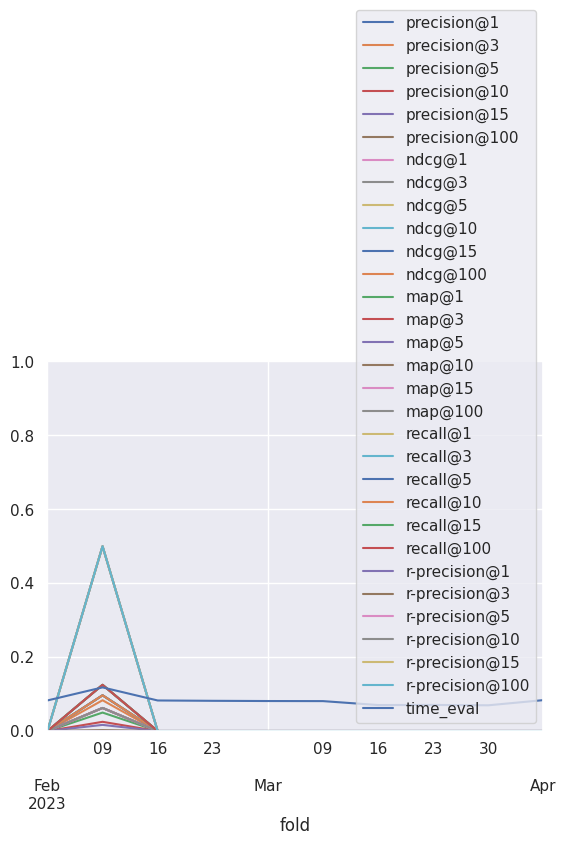

In [15]:
ax = bdf.plot()
ax.set_ylim(0, 1)

### Get perfect data

In [16]:
pdf = paths.load_perfect(ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE)
pdf = pdf[pdf.index <= CUTOFF_DATE][-LAST_FOLDS:]
pdf.mean()

precision@1        0.900000
precision@3        0.520341
precision@5        0.335538
precision@10       0.167769
precision@15       0.111846
precision@100      0.016777
ndcg@1             0.900000
ndcg@3             0.900000
ndcg@5             0.900000
ndcg@10            0.900000
ndcg@15            0.900000
ndcg@100           0.900000
map@1              0.900000
map@3              0.900000
map@5              0.900000
map@10             0.900000
map@15             0.900000
map@100            0.900000
recall@1           0.637545
recall@3           0.870833
recall@5           0.900000
recall@10          0.900000
recall@15          0.900000
recall@100         0.900000
r-precision@1      0.637545
r-precision@3      0.870833
r-precision@5      0.900000
r-precision@10     0.900000
r-precision@15     0.900000
r-precision@100    0.900000
time_eval          0.119380
dtype: float64

In [17]:
pdf

,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,ndcg@3,ndcg@5,ndcg@10,...,recall@10,recall@15,recall@100,r-precision@1,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_eval
fold,,,,,,,,,,,,,,,,,,,,,
2023-02-02,1.0,0.555556,0.366667,0.183333,0.122222,0.018333,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.763889,0.958333,1.0,1.0,1.0,1.0,0.127599
2023-02-09,1.0,0.416667,0.250000,0.125000,0.083333,0.012500,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.875000,1.000000,1.0,1.0,1.0,1.0,0.129055
2023-02-16,1.0,0.333333,0.200000,0.100000,0.066667,0.010000,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.000000,1.000000,1.0,1.0,1.0,1.0,0.120323
2023-02-23,1.0,0.500000,0.300000,0.150000,0.100000,0.015000,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.750000,1.000000,1.0,1.0,1.0,1.0,0.123381
2023-03-02,1.0,0.666667,0.400000,0.200000,0.133333,0.020000,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.500000,1.000000,1.0,1.0,1.0,1.0,0.121782
2023-03-09,1.0,1.000000,0.800000,0.400000,0.266667,0.040000,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.250000,0.750000,1.0,1.0,1.0,1.0,0.123648
2023-03-16,1.0,1.000000,0.600000,0.300000,0.200000,0.030000,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,0.333333,1.000000,1.0,1.0,1.0,1.0,0.124719
2023-03-23,1.0,0.333333,0.200000,0.100000,0.066667,0.010000,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.000000,1.000000,1.0,1.0,1.0,1.0,0.120047
2023-03-30,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.072926


(0.0, 1.0)

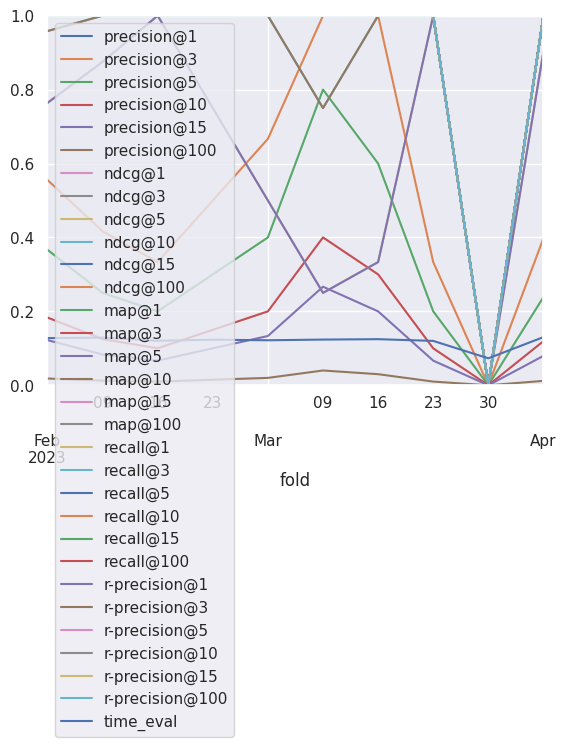

In [18]:
ax = pdf.plot()
ax.set_ylim(0, 1)

## Explore hparams

In [19]:
# Primero, obtenemos la mejor iteración, como si hubiesemos hecho early stopping
hdf = pd.concat(rg.get_dataframe(OPTIM_METRIC, OPTIM_MODE) for rg in result_grids)
print(hdf.columns)
hdf

Index(['real_batch_size', 'iteration', 'loss', 'mf_loss', 'emb_loss',
       'model_recall', 'model_ndcg', 'model_precision', 'model_map',
       'precision@1', 'precision@3', 'precision@5', 'precision@10',
       'precision@15', 'precision@100', 'ndcg@1', 'ndcg@3', 'ndcg@5',
       'ndcg@10', 'ndcg@15', 'ndcg@100', 'map@1', 'map@3', 'map@5', 'map@10',
       'map@15', 'map@100', 'recall@1', 'recall@3', 'recall@5', 'recall@10',
       'recall@15', 'recall@100', 'r-precision@1', 'r-precision@3',
       'r-precision@5', 'r-precision@10', 'r-precision@15', 'r-precision@100',
       'time_eval', 'time_train', 'time_rec', 'time_total_train',
       'time_total_test', 'done', 'training_iteration', 'trial_id', 'date',
       'timestamp', 'time_this_iter_s', 'time_total_s', 'pid', 'hostname',
       'node_ip', 'time_since_restore', 'iterations_since_restore',
       'config/batch_size', 'config/embedding_dim', 'config/conv_layers',
       'config/learning_rate', 'config/l2', 'config/window_siz

,real_batch_size,iteration,loss,mf_loss,emb_loss,model_recall,model_ndcg,model_precision,model_map,precision@1,...,time_since_restore,iterations_since_restore,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold,logdir
0,20,55,0.189014,1.657091e-09,0.189014,0.0,0.0,0.0,0.0,0.444444,...,2.302782,11,7,23,4,0.3532,3.075100e-04,21d,2022-03-03T00:00:00,d8e97eca
1,20,95,0.075935,7.582040e-02,0.000114,0.0,0.0,0.0,0.0,0.444444,...,3.599787,19,9,2,1,0.1233,6.569316e-06,21d,2022-03-03T00:00:00,708ba0ab
2,24,95,0.009288,8.652304e-03,0.000636,0.0,0.0,0.0,0.0,0.555556,...,4.037044,19,8,5,3,0.1961,3.543605e-06,30d,2022-03-03T00:00:00,78d87a0f
3,20,70,0.110002,3.696360e-02,0.073038,0.0,0.0,0.0,0.0,0.444444,...,3.227934,14,6,160,3,0.0020,5.539714e-03,21d,2022-03-03T00:00:00,db15bf94
4,46,160,8.058679,1.463803e+00,6.594875,0.0,0.0,0.0,0.0,0.444444,...,9.398367,32,7,162,4,0.6686,1.155515e-04,90d,2022-03-03T00:00:00,87b74aec
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,50,115,0.646061,6.431839e-01,0.002877,0.0,0.0,0.0,0.0,0.300000,...,6.500603,23,9,4,4,0.9179,2.284233e-06,90d,2022-05-05T00:00:00,fef7fe8c
96,179,160,0.004798,4.785429e-03,0.000012,0.0,0.0,0.0,0.0,0.100000,...,13.781010,32,9,13,4,0.0295,1.040063e-07,10YE,2022-05-05T00:00:00,bfcf7e61
97,49,35,0.146744,6.977504e-02,0.076969,0.0,0.0,0.0,0.0,0.400000,...,2.033067,7,8,219,4,0.0950,2.612311e-04,60d,2022-05-05T00:00:00,6e70c1d6
98,49,25,0.142885,1.426669e-01,0.000218,0.0,0.0,0.0,0.0,0.200000,...,1.509654,5,9,15,4,0.0061,1.421001e-05,60d,2022-05-05T00:00:00,ee4d97f3


In [20]:
# Force categorization
hdf['config/fold'] = hdf['config/fold'].astype(str)

fig = px.scatter(hdf, x='map@10', y='ndcg@10', color='config/fold')
fig.layout.update(showlegend=False)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [21]:
fig = px.scatter(hdf, x='iteration', y='loss', color='config/fold', log_y=True)
fig.layout.update(showlegend=True)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [22]:
fig = px.scatter(hdf, x='iteration', y=OPTIM_METRIC, color='config/fold', log_y=True)
fig.layout.update(showlegend=True)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [23]:
fig = px.scatter(hdf, x='loss', y='ndcg@10', color='config/fold', log_x=True)
fig.layout.update(showlegend=True)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [24]:
fig = px.scatter(hdf, x='real_batch_size', y='config/window_size', color='config/fold')
fig

In [25]:
fig = px.scatter(hdf, x=OPTIM_METRIC, y='precision@10', color='config/fold')
fig.layout.update(showlegend=False)

download_plotly(fig, 'scatter_map_precision.pdf')
fig

In [26]:
def plotly_scatter_config(config, log=True):
    config_cols = [c for c in hdf.columns if c.startswith('config/') ]
    return px.scatter(hdf, x=config, y=OPTIM_METRIC, color='config/fold', marginal_x='rug', marginal_y='rug', log_x=log, hover_data=config_cols)

plotly_scatter_config('config/embedding_dim')

In [27]:
plotly_scatter_config('config/window_size', log=False)

In [28]:
plotly_scatter_config('config/learning_rate')

In [29]:
plotly_scatter_config('config/l2')

In [30]:
plotly_scatter_config('config/batch_size', log=False)

In [31]:
plotly_scatter_config('config/conv_layers')

In [32]:
def clean_results(df: pd.DataFrame):
    hparams = [ c.removeprefix('config/') for c in df.columns if c.startswith('config/') and c not in ['config/iteration', 'config/fold'] ]
    return (
        df
        .rename(columns=lambda c: c.removeprefix('config/'),)
        .rename(columns={
            'time_total_train': 'time_train',
            'time_total_test': 'time_eval',
            'time_total_rec': 'time_rec',
        })
        .drop(columns=['real_batch_size'])
        .set_index(['fold', *hparams])
    ), hparams

clean_rdf, hparams = clean_results(rdf.copy())
clean_rdf

iteration  \
fold       batch_size embedding_dim conv_layers learning_rate l2       window_size              
2022-03-03 128        23            4           0.3532        0.000308 21d                  5   
                                                                       21d                 10   
                                                                       21d                 15   
                                                                       21d                 20   
                                                                       21d                 25   
...                                                                                       ...   
2022-05-05 512        6             4           0.1784        0.000093 90d                180   
                                                                       90d                185   
                                                                       90d                190   
                                                                       90d                195   
                                                                       90d                200   

                                                                                        loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2       window_size             
2022-03-03 128        23            4           0.3532        0.000308 21d          0.105232   
                                                                       21d          0.048931   
                                                                       21d          0.060919   
                                                                       21d          0.261394   
                                                                       21d          0.197031   
...                                                                                      ...   
2022-05-05 512        6             4           0.1784        0.000093 90d          0.054474   
                                                                       90d          0.058255   
                                                                       90d          0.035347   
                                                                       90d          0.046031   
                                                                       90d          0.045126   

                                                                                     mf_loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2       window_size             
2022-03-03 128        23            4           0.3532        0.000308 21d          0.061363   
                                                                       21d          0.000619   
                                                                       21d          0.008568   
                                                                       21d          0.188107   
                                                                       21d          0.112867   
...                                                                                      ...   
2022-05-05 512        6             4           0.1784        0.000093 90d          0.035665   
                                                                       90d          0.039840   
                                                                       90d          0.015812   
                                                                       90d          0.026499   
                                                                       90d          0.025599   

                                                                                    emb_loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2       window_size             
2022-03-03 128        23            4           0.3532        0.000308 21d          0.043869   
                                    

In [33]:
px.scatter(clean_rdf.reset_index(), y='iteration', x='loss', color='fold', log_x=True)

In [34]:
px.scatter(clean_rdf.reset_index(), x='loss', y=OPTIM_METRIC, color='fold', log_x=True)

Letting it run more iterations gets a best loss. But letting it run more does not get a best ndcg or map, as loss and the test results have not a strong correlation.

In [35]:
px.scatter(clean_rdf.reset_index(), y='iteration', x=OPTIM_METRIC, color='fold')

## Choosing best hparams

In [36]:
best_all = clean_rdf.sort_values(OPTIM_METRIC).drop_duplicates('trial_id', keep='last')
paths.save_model_results(best_all, 'lightgcn-all', ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE, K_RECOMMENDATIONS)
best_all

Saved dataframe into /home/daviddavo/recsys4daos/data/output/dxDAO - xDXdao/models/lightgcn-all_W-THU_normalize.parquet


iteration  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size              
2022-04-14 128        97            4           0.0021        6.099319e-05 10YE                65   
           1024       5             2           0.0002        3.026012e-07 10YE                 5   
           128        791           3           0.0012        1.488167e-03 10YE               195   
2022-03-24 128        1             3           0.0440        3.376852e-03 60d                  5   
2022-04-14 1024       8             4           0.0217        9.194564e-04 10YE                10   
...                                                                                           ...   
2022-03-31 64         217           2           0.4785        2.539909e-06 21d                 65   
                      50            1           0.3243        1.457535e-05 21d                 65   
2022-04-28 1024       2             3           0.8928        7.850538e-04 30d                115   
2022-03-31 128        39            2           0.0555        5.801132e-05 21d                170   
                      5             2           0.3803        2.864156e-03 21d                110   

                                                                                            loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size             
2022-04-14 128        97            4           0.0021        6.099319e-05 10YE         0.014395   
           1024       5             2           0.0002        3.026012e-07 10YE         0.690178   
           128        791           3           0.0012        1.488167e-03 10YE         0.041732   
2022-03-24 128        1             3           0.0440        3.376852e-03 60d          0.281319   
2022-04-14 1024       8             4           0.0217        9.194564e-04 10YE         0.073354   
...                                                                                          ...   
2022-03-31 64         217           2           0.4785        2.539909e-06 21d          1.877185   
                      50            1           0.3243        1.457535e-05 21d          0.232183   
2022-04-28 1024       2             3           0.8928        7.850538e-04 30d          0.323138   
2022-03-31 128        39            2           0.0555        5.801132e-05 21d          0.002562   
                      5             2           0.3803        2.864156e-03 21d          0.136209   

                                                                                         mf_loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size             
2022-04-14 128        97            4           0.0021        6.099319e-05 10YE         0.012188   
           1024       5             2           0.0002        3.026012e-07 10YE         0.690178   
           128        791           3           0.0012        1.488167e-03 10YE         0.011276   
2022-03-24 128        1             3           0.0440        3.376852e-03 60d          0.261587   
2022-04-14 1024       8             4           0.0217        9.194564e-04 10YE         0.055410   
...                                                                                          ...   
2022-03-31 64         217           2           0.4785        2.539909e-06 21d          1.802900   
                      50            1           0.3243        1.457535e-05 21d          0.182165   
2022-04-28 1024       2             3           0.8928        7.850538e-04 30d          0.289812   
2022-03-31 128        39            2           0.0555        5.801132e-05 21d          0.000358   
                      5             2           0.3803        2.864156e-03 21d          0.066527   

                                                                                            emb_loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2    

### Per fold

In [37]:
# We fix the total time in less than 250 so it has time to do the same number of iterations with the next fold
# best = rdf[rdf['time_total_train'] + rdf['time_total_test'] < 250].sort_values(OPTIM_METRIC).drop_duplicates('config/fold', keep='last').set_index('config/fold').sort_index()
idx = clean_rdf.index.names + ['iteration']
best = clean_rdf.sort_values(OPTIM_METRIC).reset_index().drop_duplicates('fold', keep='last').set_index(idx).sort_index()
paths.save_model_results(best, 'lightgcn-best-val', ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE, K_RECOMMENDATIONS)
best

Saved dataframe into /home/daviddavo/recsys4daos/data/output/dxDAO - xDXdao/models/lightgcn-best-val_W-THU_normalize.parquet


,,,,,,,,loss,mf_loss,emb_loss,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,...,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_rec,time_train,time_eval,done,trial_id
fold,batch_size,embedding_dim,conv_layers,learning_rate,l2,window_size,iteration,,,,,,,,,,,,,,,,,,,,,
2022-03-03,256,751,3,0.1600,0.000050,21d,140,0.633209,0.000000,0.633209,0.777778,0.518519,0.355556,0.277778,0.222222,0.035556,0.777778,...,0.517708,0.558333,0.605208,0.605208,0.605208,0.001382,1.395542,3.707971,False,c12345d1
2022-03-10,64,996,1,0.1041,0.000689,21d,5,0.735446,0.472365,0.263081,0.727273,0.424242,0.418182,0.372727,0.284848,0.053636,0.727273,...,0.272046,0.391755,0.550705,0.550705,0.550705,0.035925,0.232160,0.139264,False,4359caf4
2022-03-17,64,990,3,0.5659,0.000001,30d,45,2.850683,2.593881,0.256802,0.500000,0.388889,0.400000,0.341667,0.250000,0.037500,0.500000,...,0.469898,0.663435,0.784184,0.784184,0.784184,0.002772,1.373553,1.346394,False,e4ba889c
2022-03-24,128,437,1,0.0188,0.000603,60d,55,0.034039,0.008606,0.025434,0.538462,0.205128,0.169231,0.150000,0.130769,0.024231,0.538462,...,0.687778,0.678125,0.714583,0.714583,0.714583,0.001444,1.504201,1.553935,False,1b753e00
2022-03-31,128,5,2,0.3803,0.002864,21d,110,0.136209,0.066527,0.069682,0.400000,0.366667,0.380000,0.270000,0.180000,0.027000,0.400000,...,0.552083,0.633333,0.633333,0.633333,0.633333,0.001320,1.489896,2.925710,False,30bd0106
2022-04-07,64,194,1,0.0003,0.000089,30d,35,0.235208,0.234795,0.000413,0.538462,0.358974,0.276923,0.276923,0.215385,0.039231,0.538462,...,0.485417,0.520139,0.586111,0.586111,0.586111,0.001262,0.661377,0.960611,False,b5a07ba9
2022-04-14,64,1,1,0.6321,0.000026,60d,95,0.340871,0.340120,0.000751,0.272727,0.242424,0.145455,0.109091,0.078788,0.014545,0.272727,...,0.700000,0.700000,0.700000,0.700000,0.700000,0.001340,1.941932,2.460726,False,7e20509c
2022-04-21,128,319,1,0.5705,0.000012,60d,40,11.504464,10.585915,0.918548,0.428571,0.238095,0.242857,0.178571,0.123810,0.018571,0.428571,...,0.600000,0.600000,0.600000,0.600000,0.600000,0.001388,0.971786,1.069064,False,180eadc4
2022-04-28,1024,2,3,0.8928,0.000785,30d,115,0.323138,0.289812,0.033326,0.272727,0.454545,0.345455,0.245455,0.175758,0.026364,0.272727,...,0.501134,0.553288,0.637188,0.637188,0.637188,0.001305,2.240440,3.371775,False,5ee48c59


,precision@5,map@10
count,10.000000,10.000000
mean,0.305366,0.497785
std,0.094525,0.072554
min,0.145455,0.360859
25%,0.251374,0.449299
50%,0.332727,0.503978
75%,0.373889,0.547648
max,0.418182,0.606349


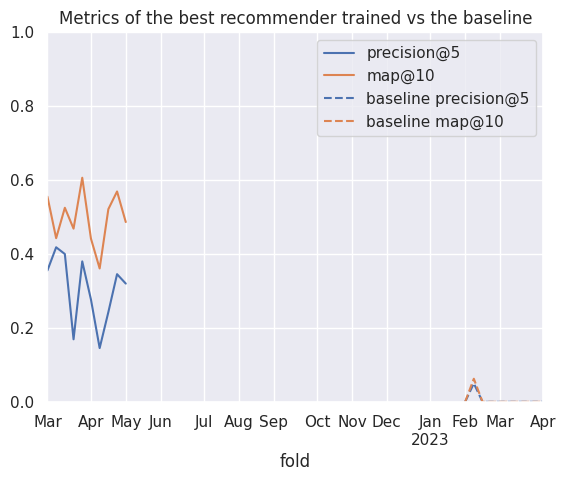

In [38]:
cols2plot = ['precision@5', 'map@10']

ax = best.reset_index().set_index('fold')[cols2plot].plot()
ax.set_ylim(0, 1)

bdf[cols2plot].rename(columns='baseline {}'.format).plot(ax=ax, style='--', color=[l.get_color() for l in ax.lines])

plt.title("Metrics of the best recommender trained vs the baseline")
best[cols2plot].describe()

In [39]:
best[['precision@5', 'ndcg@5', 'precision@10', 'ndcg@10', 'map@5', 'map@10']].mean()

precision@5     0.305366
ndcg@5          0.518697
precision@10    0.250221
ndcg@10         0.612598
map@5           0.430344
map@10          0.497785
dtype: float64

## Realisitc model (repeating hparams)

In [40]:
from pandas.api.types import is_float_dtype

config_cols = [ c for c in rdf.columns if c.startswith('config/') and c != 'config/iteration' ]
config_cols2 = config_cols + ['config/iteration']

all_configs = rdf.copy()
display(all_configs)
all_configs['config/fold'] = (pd.to_datetime(all_configs['config/fold']) + pd.tseries.frequencies.to_offset(SPLITS_FREQ)) # .astype(str)

# Leonardo Torres de Quevedo, perdoname por lo que voy a hacer
float_cols = [c for c in config_cols if is_float_dtype(all_configs[c].dtype) ]
all_configs[float_cols] = all_configs[float_cols].astype(str)
all_configs = all_configs.set_index(config_cols)
all_configs_index = all_configs.index

# all_configs_index = pd.MultiIndex.from_frame(all_configs[config_cols].astype(str))[:-1]

# No podemos utilizar los indices "tal cual" pues la coma flotante
# no encaja entre un fold y otro. Así que lo convierto a string
# y luego de nuevo a coma flotante.
# La otra solución sería usar np.isclose, pero habría que programar
# varias lineas y hacer nuestra propia función de búsqueda por cada
# columna o algo así
# O también, en lugar de str, multiplicar por 10^7 (el min. es 10**-7),
# pasar a entero, y luego dividir
aux = rdf.copy()
aux[float_cols] = aux[float_cols].astype(str)
aux = aux.set_index(config_cols)
print("Index intersection:", aux.index.intersection(all_configs_index))
all_realistic = aux.loc[aux.index.intersection(all_configs_index)]
# all_realistic.index = all_realistic.index.set_levels(
#     [ pd.to_numeric(l) for l in realistic.index.levels ]
# )
all_realistic

,real_batch_size,config/iteration,loss,mf_loss,emb_loss,precision@1,precision@3,precision@5,precision@10,precision@15,...,time_total_test,done,trial_id,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold
0,20,5,0.105232,0.061363,0.043869,0.333333,0.333333,0.266667,0.255556,0.229630,...,0.131228,False,d8e97eca,128,23,4,0.3532,0.000308,21d,2022-03-03
1,20,10,0.048931,0.000619,0.048312,0.333333,0.296296,0.288889,0.266667,0.222222,...,0.263137,False,d8e97eca,128,23,4,0.3532,0.000308,21d,2022-03-03
2,20,15,0.060919,0.008568,0.052352,0.444444,0.296296,0.311111,0.255556,0.222222,...,0.395693,False,d8e97eca,128,23,4,0.3532,0.000308,21d,2022-03-03
3,20,20,0.261394,0.188107,0.073287,0.333333,0.370370,0.333333,0.255556,0.237037,...,0.530016,False,d8e97eca,128,23,4,0.3532,0.000308,21d,2022-03-03
4,20,25,0.197031,0.112867,0.084165,0.333333,0.333333,0.288889,0.266667,0.237037,...,0.661783,False,d8e97eca,128,23,4,0.3532,0.000308,21d,2022-03-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35,50,180,0.054474,0.035665,0.018809,0.000000,0.133333,0.200000,0.240000,0.220000,...,4.804610,False,5d3ab004,512,6,4,0.1784,0.000093,90d,2022-05-05
36,50,185,0.058255,0.039840,0.018415,0.000000,0.233333,0.240000,0.260000,0.220000,...,4.938799,False,5d3ab004,512,6,4,0.1784,0.000093,90d,2022-05-05
37,50,190,0.035347,0.015812,0.019535,0.000000,0.166667,0.200000,0.240000,0.220000,...,5.066304,False,5d3ab004,512,6,4,0.1784,0.000093,90d,2022-05-05
38,50,195,0.046031,0.026499,0.019532,0.000000,0.166667,0.220000,0.240000,0.220000,...,5.195381,False,5d3ab004,512,6,4,0.1784,0.000093,90d,2022-05-05


Index intersection: MultiIndex([( 512, 665, 3,                '0.0092', ...),
            ( 512,   3, 2,                '0.0001', ...),
            ( 512,  26, 2,                '0.6694', ...),
            ( 512, 447, 3,                '0.0008', ...),
            (  64, 217, 2,   '0.47850000000000004', ...),
            ( 256,  96, 2,                '0.0784', ...),
            ( 256, 219, 4,                 '0.095', ...),
            (1024, 364, 2,                '0.0002', ...),
            ( 128,  73, 4,  '0.041800000000000004', ...),
            ( 256, 241, 2, '0.0017000000000000001', ...),
            ...
            (  64, 217, 2,   '0.47850000000000004', ...),
            ( 128,  34, 2,                '0.0091', ...),
            (1024, 364, 2,                '0.0002', ...),
            ( 256,  96, 2,                '0.0784', ...),
            ( 128,  74, 2,                '0.1736', ...),
            ( 512, 447, 3,                '0.0008', ...),
            ( 256, 241, 2, '0.001700

real_batch_size  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate config/l2              config/window_size config/fold                    
512               665                  3                  0.0092               2.7445636362385535e-05 90d                2022-03-10                43   
                                                                                                                         2022-03-10                43   
                                                                                                                         2022-03-10                43   
                                                                                                                         2022-03-10                43   
                                                                                                                         2022-03-10                43   
...                                                                                                                                               ...   
256               219                  4                  0.095                0.0002612310958370494  60d                2022-05-05                49   
                                                                                                                         2022-05-05                49   
                                                                                                                         2022-05-05                49   
                                                                                                                         2022-05-05                49   
                                                                                                                         2022-05-05                49   

                                                                                                                                      config/iteration  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate config/l2              config/window_size config/fold                     
512               665                  3                  0.0092               2.7445636362385535e-05 90d                2022-03-10                  5   
                                                                                                                         2022-03-10                 10   
                                                                                                                         2022-03-10                 15   
                                                                                                                         2022-03-10                 20   
                                                                                                                         2022-03-10                 25   
...                                                                                                                                                ...   
256               219                  4                  0.095                0.0002612310958370494  60d                2022-05-05                180   
                                                                                                                         2022-05-05                185   
                                                                                                                         2022-05-05                190   
                                                                                                                         2022-05-05                195   
                                                                                                                         2022-05-05                200   

                                                                                                                                          los

In [41]:
def bestByFold(df):
    idx = df[OPTIM_METRIC].idxmax()
    return df.loc[idx]

best_configs = (
    all_configs.loc[all_configs.index.intersection(all_realistic.index)]
    .reset_index()
    .groupby("config/fold")
    .apply(bestByFold)
    .set_index(config_cols)
    # .rename(columns="best_{}".format)
)
best_configs

/tmp/ipykernel_3823779/543710717.py:9: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



real_batch_size  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate config/l2              config/window_size config/fold                    
128               73                   4                  0.041800000000000004 0.00010195780832501491 21d                2022-03-10                20   
256               27                   2                  0.2056               3.060064883897499e-05  30d                2022-03-17                24   
512               26                   2                  0.6694               1.4272116622201335e-06 30d                2022-03-24                21   
                  3                    2                  0.0001               0.0015850583576508905  30d                2022-03-31                43   
64                217                  2                  0.47850000000000004  2.539908649333967e-06  21d                2022-04-07                46   
512               26                   2                  0.6694               1.4272116622201335e-06 30d                2022-04-14                47   
                  3                    2                  0.0001               0.0015850583576508905  30d                2022-04-21                46   
128               319                  1                  0.5705               1.1557636403759147e-05 60d                2022-04-28                48   
256               219                  4                  0.095                0.0002612310958370494  60d                2022-05-05                49   

                                                                                                                                      config/iteration  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate config/l2              config/window_size config/fold                     
128               73                   4                  0.041800000000000004 0.00010195780832501491 21d                2022-03-10                200   
256               27                   2                  0.2056               3.060064883897499e-05  30d                2022-03-17                 15   
512               26                   2                  0.6694               1.4272116622201335e-06 30d                2022-03-24                 45   
                  3                    2                  0.0001               0.0015850583576508905  30d                2022-03-31                  5   
64                217                  2                  0.47850000000000004  2.539908649333967e-06  21d                2022-04-07                 65   
512               26                   2                  0.6694               1.4272116622201335e-06 30d                2022-04-14                 15   
                  3                    2                  0.0001               0.0015850583576508905  30d                2022-04-21                 85   
128               319                  1                  0.5705               1.1557636403759147e-05 60d                2022-04-28                 40   
256               219                  4                  0.095                0.0002612310958370494  60d                2022-05-05                 50   

                                                                                                                                           loss  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate config/l2              config/window_size config/fold              
128               73                   4                  0.041800000000000004 0.00010195780832501491 21d                2022-03-10    0.004617   
256               27                   2                  0.2056               3.060064883897499e-05  30d                2022-03-17    0.251904   
512               26                   2                  0.6694               1.4272116622201335e-06 30d                2022-03-24    0.010665   
                  3 

In [42]:
best_realistic = all_realistic.join(best_configs.rename(columns="best_{}".format), how='right')

# Display the configs, to see that nothing is missing
display(best_realistic.groupby(best_realistic.index).size())

# First, do the "early stopping" (keep only the ones that are the same iterations or less)
best_realistic = best_realistic[best_realistic['config/iteration'] <= best_realistic['best_config/iteration']]
# Now, lets keep just the one with the best iteration
best_realistic = (
    best_realistic.sort_values('config/iteration')
    .groupby('config/fold')
    .tail(1)
    .sort_index()
    .reset_index()
    .set_index('config/fold')
    .sort_index()
)
best_realistic

(64, 217, 2, 0.47850000000000004, 2.539908649333967e-06, 21d, 2022-04-07 00:00:00)      40
(128, 73, 4, 0.041800000000000004, 0.00010195780832501491, 21d, 2022-03-10 00:00:00)    40
(128, 319, 1, 0.5705, 1.1557636403759147e-05, 60d, 2022-04-28 00:00:00)                 40
(256, 27, 2, 0.2056, 3.060064883897499e-05, 30d, 2022-03-17 00:00:00)                   40
(256, 219, 4, 0.095, 0.0002612310958370494, 60d, 2022-05-05 00:00:00)                   40
(512, 3, 2, 0.0001, 0.0015850583576508905, 30d, 2022-03-31 00:00:00)                    40
(512, 3, 2, 0.0001, 0.0015850583576508905, 30d, 2022-04-21 00:00:00)                    40
(512, 26, 2, 0.6694, 1.4272116622201335e-06, 30d, 2022-03-24 00:00:00)                  40
(512, 26, 2, 0.6694, 1.4272116622201335e-06, 30d, 2022-04-14 00:00:00)                  40
dtype: int64

,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,real_batch_size,config/iteration,loss,mf_loss,...,best_r-precision@3,best_r-precision@5,best_r-precision@10,best_r-precision@15,best_r-precision@100,best_time_rec,best_time_total_train,best_time_total_test,best_done,best_trial_id
config/fold,,,,,,,,,,,,,,,,,,,,,
2022-03-10,128,73,4,0.041800000000000004,0.00010195780832501491,21d,19,200,0.007292,0.001397,...,0.537500,0.666667,0.687500,0.687500,0.687500,0.001674,1.950861,5.340598,True,a03a84de
2022-03-17,256,27,2,0.2056,3.060064883897499e-05,30d,21,15,0.034640,0.026591,...,0.446429,0.426367,0.566138,0.566138,0.566138,0.002600,0.407952,0.400224,False,a8608603
2022-03-24,512,26,2,0.6694,1.4272116622201335e-06,30d,43,45,0.012536,0.004549,...,0.349802,0.547817,0.685714,0.685714,0.685714,0.001678,1.433890,1.586649,False,03b358ad
2022-03-31,512,3,2,0.0001,0.0015850583576508905,30d,46,5,0.689403,0.689214,...,0.561111,0.567500,0.596667,0.596667,0.596667,0.024404,0.242476,0.147040,False,3c7e37fd
2022-04-07,64,217,2,0.47850000000000004,2.539908649333967e-06,21d,45,65,2.822185,2.754147,...,0.647222,0.713889,0.713889,0.713889,0.713889,0.001485,1.085971,1.747595,False,866f8606
2022-04-14,512,26,2,0.6694,1.4272116622201335e-06,30d,46,15,0.833687,0.831098,...,0.479167,0.484568,0.533951,0.552469,0.552469,0.001934,0.468773,0.433023,False,a0390e9c
2022-04-21,512,3,2,0.0001,0.0015850583576508905,30d,43,85,0.682044,0.681787,...,0.400000,0.600000,0.600000,0.600000,0.600000,0.001480,1.220631,2.278244,False,ee502146
2022-04-28,128,319,1,0.5705,1.1557636403759147e-05,60d,49,40,35.020134,34.100955,...,0.600000,0.600000,0.600000,0.600000,0.600000,0.001388,0.971786,1.069064,False,180eadc4
2022-05-05,256,219,4,0.095,0.0002612310958370494,60d,49,50,0.122327,0.001225,...,0.662698,0.728836,0.826720,0.826720,0.826720,0.001267,1.414948,1.370172,False,22674227


In [43]:
paths.save_model_results(
    clean_results(best_realistic.reset_index().copy())[0],
    'lightgcn-best-test',
    ORG_NAME,
    SPLITS_FREQ,
    SPLITS_NORMALIZE,
    K_RECOMMENDATIONS,
)

Saved dataframe into /home/daviddavo/recsys4daos/data/output/dxDAO - xDXdao/models/lightgcn-best-test_W-THU_normalize.parquet


,precision@5,map@10
count,9.000000,9.000000
mean,0.172394,0.234084
std,0.049887,0.102457
min,0.072727,0.083041
25%,0.160000,0.214910
50%,0.183333,0.222493
75%,0.200000,0.297868
max,0.236364,0.391134


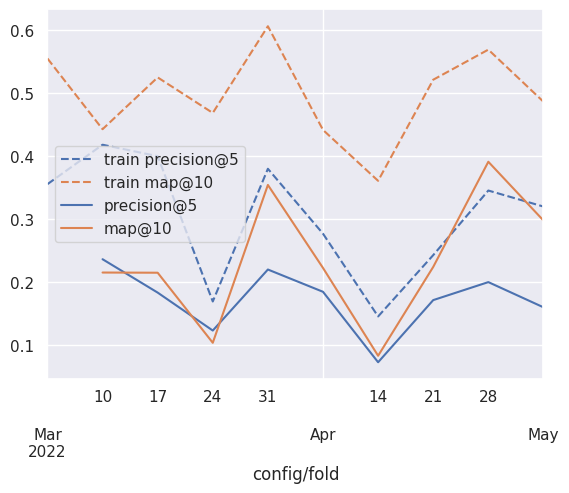

In [44]:
_toplot = best_realistic.copy().sort_index()
_toplot.index = pd.to_datetime(_toplot.index)

ax = best.reset_index().set_index('fold')[cols2plot].rename(columns='train {}'.format).plot(style='--', color=[l.get_color() for l in ax.lines])
# plt.xticks(range(10))
# bdf[cols2plot].rename(columns='baseline {}'.format).reset_index(drop=True).plot(ax=ax, style=':', color=[l.get_color() for l in ax.lines])

_toplot[cols2plot].plot(ax=ax)
# ax.set_ylim(0, 1)

_toplot[cols2plot].describe()

In [45]:
best_realistic.index.min()

Timestamp('2022-03-10 00:00:00')

In [46]:
bdf

,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,ndcg@3,ndcg@5,ndcg@10,...,recall@10,recall@15,recall@100,r-precision@1,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_eval
fold,,,,,,,,,,,,,,,,,,,,,
2023-02-02,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.082786
2023-02-09,0.0,0.083333,0.05,0.025,0.016667,0.0025,0.0,0.096713,0.096713,0.096713,...,0.125,0.125,0.125,0.0,0.5,0.5,0.5,0.5,0.5,0.118132
2023-02-16,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.082722
2023-02-23,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.081805
2023-03-02,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.081221
2023-03-09,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.080990
2023-03-16,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.070354
2023-03-23,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.070659
2023-03-30,0.0,0.000000,0.00,0.000,0.000000,0.0000,0.0,0.000000,0.000000,0.000000,...,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.069689


In [47]:
_PERFECT_NAME = 'Ground Truth'
_LEAK_NAME = 'Leaky GNN'
CAT_ORDER = [_PERFECT_NAME, _LEAK_NAME, 'GNN', 'OpenPop']

def _get_toplot_table(metrics2plot=cols2plot, oracle=True, perfect=None, common_only=False):
    if perfect is None:
        perfect = metrics2plot
    
    # _toplot = best_realistic.copy()
    # _toplot.index = pd.to_numeric(_toplot.index)
    # _toplot['fold'] = _toplot.index

    _first_real_fold_idx = best_realistic.index.min()
    
    _toplot_real = best_realistic[metrics2plot].copy()
    _toplot_real['fold'] = pd.to_datetime(_toplot_real.index) # .astype(int)
    _toplot_real['rec'] = 'GNN'

    _toplot_base = bdf[metrics2plot].copy()
    # fold2str = _toplot_base.index.strftime('%G-W%V')
    # _toplot_base['fold'] = range(len(_toplot_base))
    _toplot_base['fold'] = pd.to_datetime(_toplot_base.index)
    _toplot_base['rec'] = 'OpenPop'

    # _colsbest = map("best_{}".format, _cols)
    if oracle:
        _toplot_best = best.reset_index().set_index('fold')[metrics2plot].copy() # [_colsbest].rename(columns=lambda x: x.split("_", 1)[-1])
        _toplot_best['fold'] = _toplot_best.index
        _toplot_best['rec'] = _LEAK_NAME
    else:
        _toplot_best = None
        _toplot_base = _toplot_base[_toplot_base['fold'] >= _first_real_fold_idx]
        _toplot_real = _toplot_real[_toplot_real['fold'] >= _first_real_fold_idx]

    if perfect:
        _toplot_perfect = pdf[perfect].copy()
        _toplot_perfect['fold'] = pd.to_datetime(_toplot_perfect.index)
        _toplot_perfect['rec'] = _PERFECT_NAME
        # Make same len as baseline
        # _toplot_perfect = _toplot_perfect.iloc[-len(_toplot_base):]
        _toplot_perfect = _toplot_perfect.loc[_toplot_base.index]
        assert _toplot_perfect.index.equals(_toplot_base.index)
    else:
        _toplot_perfect = None
        
    _toplot = (
        pd.concat((
            _toplot_real, 
            _toplot_best,
            _toplot_base,
            _toplot_perfect,
        ), ignore_index=True)
        .melt(id_vars=['fold', 'rec'], value_vars=metrics2plot, var_name='metric')
    )

    assert pd.api.types.is_datetime64_any_dtype(_toplot['fold'].dtype), "Fold column should be datetime"
    assert not (_toplot['fold'].isna()).any()
    
    _toplot['rec'] = pd.Categorical(_toplot['rec'], CAT_ORDER)
    _toplot['fold_week'] = _toplot['fold'].dt.strftime('%G-W%V') # fold2str[_toplot['fold']]

    return _toplot.sort_values('fold')

_tablecols = ['precision@5', 'precision@10', 'recall@5', 'recall@10', 'map@5', 'map@10', 'ndcg@5', 'ndcg@10']
_table = _get_toplot_table(_tablecols)
# Skip the first fold so everyone has 9 folds and metrics are consistent
_table = _table[_table['fold'] >= best_realistic.index.min()]
print(_table.groupby(['rec', 'metric'])['value'].mean().unstack(level=-1)[_tablecols].rename(
    index={
        'Perfect': 'Ground Truth',
        'realistic': 'GNN'
    }
).style.format(precision=2).to_latex())
_table.groupby(['rec', 'metric']).describe()

\begin{tabular}{lrrrrrrrr}
metric & precision@5 & precision@10 & recall@5 & recall@10 & map@5 & map@10 & ndcg@5 & ndcg@10 \\
rec &  &  &  &  &  &  &  &  \\
Ground Truth & 0.34 & 0.17 & 0.90 & 0.90 & 0.90 & 0.90 & 0.90 & 0.90 \\
Leaky GNN & 0.30 & 0.25 & 0.55 & 0.80 & 0.43 & 0.49 & 0.51 & 0.61 \\
GNN & 0.17 & 0.20 & 0.24 & 0.60 & 0.15 & 0.23 & 0.22 & 0.36 \\
OpenPop & 0.01 & 0.00 & 0.01 & 0.01 & 0.01 & 0.01 & 0.01 & 0.01 \\
\end{tabular}



/tmp/ipykernel_3823779/3868849439.py:68: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipykernel_3823779/3868849439.py:74: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



fold                                            \
                          count                 mean                  min   
rec          metric                                                         
Ground Truth map@10          10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             map@5           10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             ndcg@10         10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             ndcg@5          10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             precision@10    10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             precision@5     10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             recall@10       10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             recall@5        10  2023-03-05 12:00:00  2023-02-02 00:00:00   
Leaky GNN    map@10           9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             map@5            9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             ndcg@10          9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             ndcg@5           9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             precision@10     9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             precision@5      9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             recall@10        9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             recall@5         9  2022-04-07 00:00:00  2022-03-10 00:00:00   
GNN          map@10           9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             map@5            9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             ndcg@10          9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             ndcg@5           9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             precision@10     9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             precision@5      9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             recall@10        9  2022-04-07 00:00:00  2022-03-10 00:00:00   
             recall@5         9  2022-04-07 00:00:00  2022-03-10 00:00:00   
OpenPop      map@10          10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             map@5           10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             ndcg@10         10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             ndcg@5          10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             precision@10    10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             precision@5     10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             recall@10       10  2023-03-05 12:00:00  2023-02-02 00:00:00   
             recall@5        10  2023-03-05 12:00:00  2023-02-02 00:00:00   

                                                                     \
                                           25%                  50%   
rec          metric                                                   
Ground Truth map@10        2023-02-17 18:00:00  2023-03-05 12:00:00   
             map@5         2023-02-17 18:00:00  2023-03-05 12:00:00   
             ndcg@10       2023-02-17 18:00:00  2023-03-05 12:00:00   
             ndcg@5        2023-02-17 18:00:00  2023-03-05 12:00:00   
             precision@10  2023-02-17 18:00:00  2023-03-05 12:00:00   
             precision@5   2023-02-17 18:00:00  2023-03-05 12:00:00   
             recall@10     2023-02-17 18:00:00  2023-03-05 12:00:00   
             recall@5      2023-02-17 18:00:00  2023-03-05 12:00:00   
Leaky GNN    map@10        2022-03-24 00:00:00  2022-04-07 00:00:00   
             map@5         2022-03-24 00:00:00  2022-04-07 00:00:00   
             ndcg@10       2022-03-24 00:00:00  2022-04-07 00:00:00   
             ndcg@5        2022-03-24 00:00:00  2022-04-07 00:00:00   
             precision@10  2022-03-24 00:00:00  2022-04-07 00:00:00   
             precision@5   2022-03-24 00:00:00  2022-04-07 00:00:00   
             recall@10     2022-03-24 00:00:00  2022-04-07 00:00:00   
             recall@5      2022-03-24 00:00:00  2022-

/tmp/ipykernel_3823779/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3823779/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



count      mean       std       min       25%  \
rec          metric                                                       
Ground Truth map@10        10.0  0.900000  0.316228  0.000000  1.000000   
             precision@5   10.0  0.335538  0.225603  0.000000  0.209677   
Leaky GNN    map@10        10.0  0.497785  0.072554  0.360859  0.449299   
             precision@5   10.0  0.305366  0.094525  0.145455  0.251374   
GNN          map@10         9.0  0.234084  0.102457  0.083041  0.214910   
             precision@5    9.0  0.172394  0.049887  0.072727  0.160000   
OpenPop      map@10        10.0  0.006250  0.019764  0.000000  0.000000   
             precision@5   10.0  0.005000  0.015811  0.000000  0.000000   

                               50%       75%       max  
rec          metric                                     
Ground Truth map@10       1.000000  1.000000  1.000000  
             precision@5  0.275000  0.391667  0.800000  
Leaky GNN    map@10       0.503978  0.547648  0.606349  
             precision@5  0.332727  0.373889  0.418182  
GNN          map@10       0.222493  0.297868  0.391134  
             precision@5  0.183333  0.200000  0.236364  
OpenPop      map@10       0.000000  0.000000  0.062500  
             precision@5  0.000000  0.000000  0.050000

Cannot show ipywidgets in text

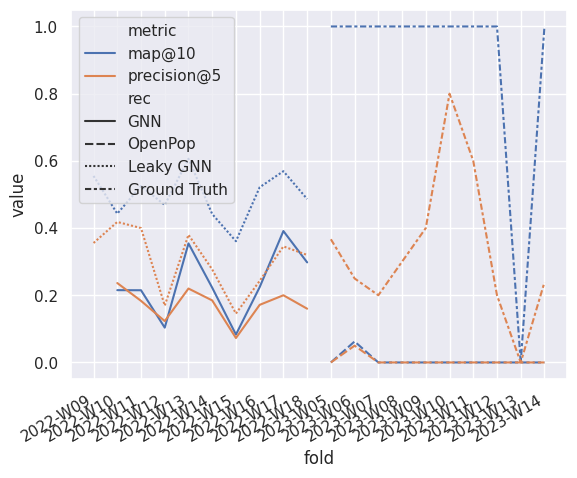

In [48]:
def plot_gnn_results(metrics2plot=cols2plot, oracle=False, perfect=None, common_only=False):
    _toplot = _get_toplot_table(metrics2plot, oracle, perfect)

    if common_only:
        _toplot = _toplot[_toplot['fold'] >= best_realistic.index.min()]

    ax = sns.lineplot(
        _toplot, x='fold_week', y='value', 
        hue='metric' if len(metrics2plot) > 1 else None, 
        style='rec',
        style_order=['GNN', 'OpenPop', _LEAK_NAME, _PERFECT_NAME],
    )
    ax.set_xlabel('fold')
    
    if len(metrics2plot) == 1:
        ax.set_ylabel(metrics2plot[0])
        ax.legend_.set_title(None)

    # ax.set_xticks(ax.get_xticks()[1:-1], _toplot_base.index.strftime('%G-W%V'), rotation=30, ha='right')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=30, ha='right')

    display(_toplot.groupby(['rec', 'metric'])['value'].describe())
    # print(_toplot.groupby(['rec', 'metric'])['value'].describe()[['mean', 'std', '50%', 'min', 'max']].to_html())

    return ax

ax = plot_gnn_results(oracle=True) # perfect=['precision@5'])
download_matplotlib(ax.figure, '09_gnn_results.pdf')

/tmp/ipykernel_3823779/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3823779/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,precision@5,10.0,0.335538,0.225603,0.000000,0.209677,0.275000,0.391667,0.800000
GNN,precision@5,9.0,0.172394,0.049887,0.072727,0.160000,0.183333,0.200000,0.236364
OpenPop,precision@5,10.0,0.005000,0.015811,0.000000,0.000000,0.000000,0.000000,0.050000


Cannot show ipywidgets in text

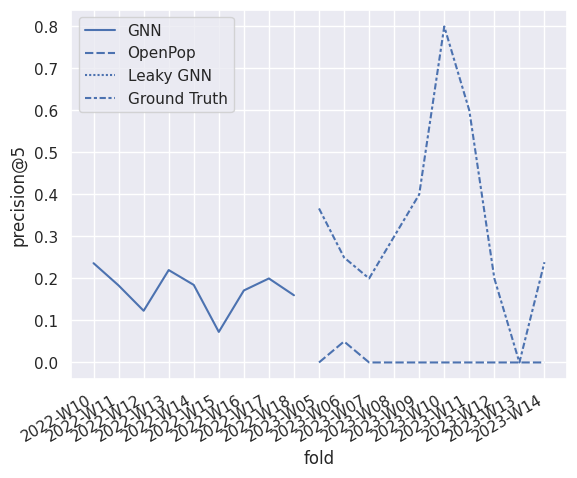

In [49]:
ax = plot_gnn_results(['precision@5'])
ax.figure.savefig('../figures/09_gnn_results_precision_5.png', bbox_inches='tight')
download_matplotlib(ax.figure, '09_gnn_results_precision_5.pdf')

/tmp/ipykernel_3823779/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3823779/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,precision@5,10.0,0.335538,0.225603,0.000000,0.209677,0.275000,0.391667,0.800000
Leaky GNN,precision@5,9.0,0.299789,0.098498,0.145455,0.242857,0.320000,0.380000,0.418182
GNN,precision@5,9.0,0.172394,0.049887,0.072727,0.160000,0.183333,0.200000,0.236364
OpenPop,precision@5,10.0,0.005000,0.015811,0.000000,0.000000,0.000000,0.000000,0.050000


Cannot show ipywidgets in text

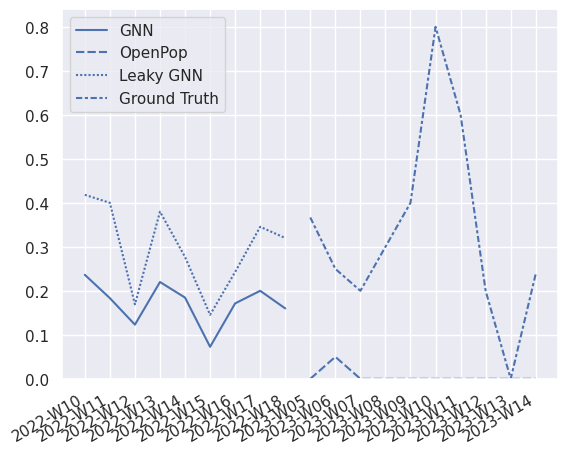

In [50]:
ax = plot_gnn_results(['precision@5'], oracle=True, common_only=True)

ax.set_xlabel('')
ax.set_ylabel('')
ax.set_ylim(0)

download_matplotlib(ax.figure, '09_gnn_results_precision_5_leaky.pdf')

/tmp/ipykernel_3823779/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3823779/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,map@10,10.0,0.900000,0.316228,0.000000,1.00000,1.000000,1.000000,1.000000
GNN,map@10,9.0,0.234084,0.102457,0.083041,0.21491,0.222493,0.297868,0.391134
OpenPop,map@10,10.0,0.006250,0.019764,0.000000,0.00000,0.000000,0.000000,0.062500


Cannot show ipywidgets in text

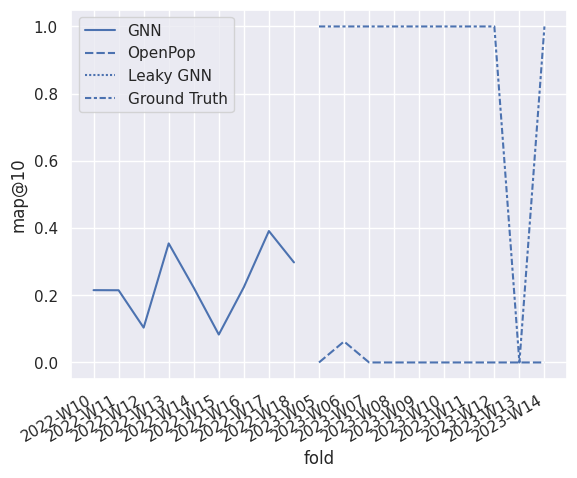

In [51]:
ax = plot_gnn_results(['map@10']) #, perfect=False)
ax.figure.savefig('../figures/09_gnn_results_map_10.png', bbox_inches='tight')
download_matplotlib(ax.figure, '09_gnn_results_map_10.pdf')

/tmp/ipykernel_3823779/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3823779/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,ndcg@10,10.0,0.900000,0.316228,0.000000,1.000000,1.000000,1.00000,1.000000
GNN,ndcg@10,9.0,0.359149,0.136730,0.142059,0.313851,0.357811,0.45227,0.550517
OpenPop,ndcg@10,10.0,0.009671,0.030583,0.000000,0.000000,0.000000,0.00000,0.096713


Cannot show ipywidgets in text

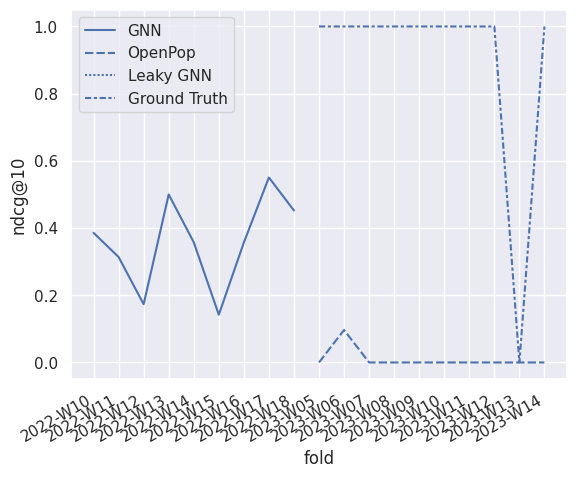

In [52]:
ax = plot_gnn_results(['ndcg@10']) #, perfect=False)
ax.figure.savefig('../figures/09_gnn_results_ndcg_10.png', bbox_inches='tight')
download_matplotlib(ax.figure, '09_gnn_results_ndcg_10.pdf')

/tmp/ipykernel_3823779/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3823779/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,ndcg@10,10.0,0.900000,0.316228,0.000000,1.000000,1.000000,1.000000,1.000000
Leaky GNN,ndcg@10,9.0,0.607233,0.087944,0.440452,0.561122,0.617277,0.659813,0.734289
GNN,ndcg@10,9.0,0.359149,0.136730,0.142059,0.313851,0.357811,0.452270,0.550517
OpenPop,ndcg@10,10.0,0.009671,0.030583,0.000000,0.000000,0.000000,0.000000,0.096713


Cannot show ipywidgets in text

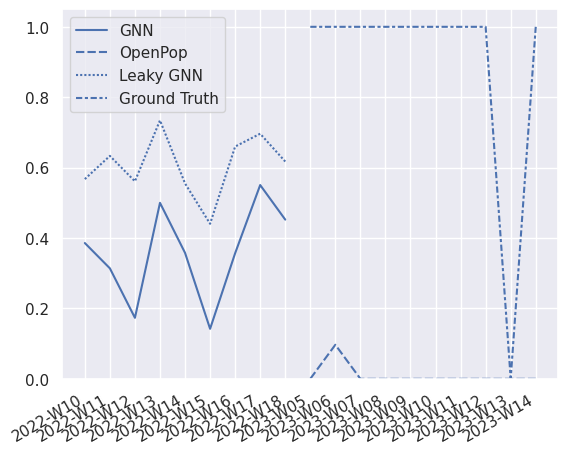

In [53]:
ax = plot_gnn_results(['ndcg@10'], oracle=True, common_only=True)

ax.set_xlabel('')
ax.set_ylabel('')
ax.set_ylim(0)

download_matplotlib(ax.figure, '09_gnn_results_ndcg_10_leaky.pdf')